<html class="" data-disabled="appDownload" lang="en"><head><script async="" src="https://connect.facebook.net/signals/config/780279355814318?v=2.9.229&amp;r=stable&amp;domain=www.webnovel.com&amp;hme=4da26a2e1598cd081171e9b8b0e3bd97fd7c10093fe0828a931452a008126d2c&amp;ex_m=87%2C149%2C129%2C18%2C122%2C61%2C41%2C123%2C68%2C60%2C136%2C76%2C12%2C86%2C26%2C117%2C108%2C66%2C69%2C116%2C133%2C95%2C138%2C6%2C2%2C3%2C5%2C4%2C1%2C77%2C85%2C139%2C213%2C161%2C55%2C218%2C215%2C216%2C48%2C176%2C25%2C65%2C222%2C221%2C164%2C28%2C54%2C7%2C57%2C81%2C82%2C83%2C88%2C112%2C27%2C24%2C115%2C111%2C110%2C130%2C67%2C132%2C131%2C43%2C113%2C53%2C105%2C11%2C135%2C38%2C204%2C206%2C171%2C21%2C22%2C23%2C15%2C16%2C37%2C33%2C35%2C34%2C72%2C78%2C80%2C93%2C121%2C124%2C39%2C94%2C19%2C17%2C99%2C62%2C31%2C126%2C125%2C127%2C118%2C20%2C30%2C52%2C92%2C134%2C63%2C14%2C29%2C186%2C157%2C263%2C202%2C147%2C189%2C182%2C90%2C114%2C71%2C103%2C47%2C40%2C101%2C102%2C107%2C51%2C13%2C109%2C100%2C58%2C42%2C96%2C46%2C49%2C45%2C84%2C137%2C0%2
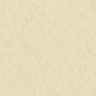
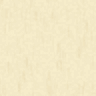
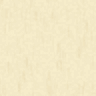
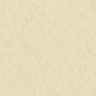
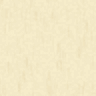
...
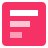
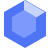
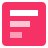
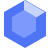
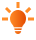

In [2]:
from selenium import webdriver
from bs4 import BeautifulSoup
import time


def get_soup(link: str):
    # mở trình duyệt
    driver = webdriver.Chrome()
    driver.get(link)

    # đợi JS load dữ liệu
    time.sleep(5)

    # lấy HTML sau khi render
    html = driver.page_source
    soup = BeautifulSoup(html, "html.parser")

    print(soup)
    abc = soup.find('div', class_ = 'chapter_content j_chapter_44923504721723328  para-comment-allowed')
    print(abc)
    driver.quit()
    
    return soup

#test:
soup = get_soup('https://www.webnovel.com/book/my-vampire-system_16709365405930105/result_44969012853008295')


In [5]:
content_div = soup.find('div', class_ = 'cha-content')
# print(content_div)
text_divs = soup.find_all('div', class_ = 'dib pr')
text_divs

[<div class="dib pr"> <p>Quinn considered this entire charade to be ridiculous. It was quite clear to him that the tablet Jane held already had all the information on him from his previous school. They should know that he had never possessed any ability and that his financial status would never allow him to buy one… and yet he struggled with the answer to her question.</p> <i class="icon para-comment j_open_para_comment j_para_comment_count" data-report-eid="qi_A_paraendbubble" data-report-l1="1" data-report-pdid="16709365405930105" data-report-uiname="paraendbubble"></i> </div>,
 <div class="dib pr"> <p>Before coming to military school Quinn had done a bit of research himself. Unlike Peter, he already knew that the military freely gave all students who had no ability their very own ability book. Everyone would receive a level 1 Earth ability book.</p> <i class="icon para-comment j_open_para_comment j_para_comment_count" data-report-eid="qi_A_paraendbubble" data-report-l1="1" data-repo

In [137]:
import re
def get_text_en(link:str, story_name:str, numchap:int):
    soup = get_soup(link)
    
    content_div = soup.find('div', class_ = 'cha-content')
    text_divs = content_div.find_all('div', class_ = 'dib pr')
    texts = [text_div.find('p').get_text() for text_div in text_divs]
    # print(texts[1])
    merge = "\n".join(texts)
    # sentences = re.split(r'(?<=[.!?])\s+', merge)
    # result = "\n".join(sentences)
    
    return f"Story '{story_name}' - Chapter {numchap}\n\n".upper() + merge

In [136]:
def get_text_vi(link:str, story_name:str, numchap:int):
    soup = get_soup(link)
    content_div = soup.find('div', class_ = 'long-text no-select text-justify')
    text_divs = content_div.find_all('p')
    texts = [text_div.get_text() for text_div in text_divs]
    print(texts[0])
    merge = "\n".join(texts)
    
    return f"Truyện '{story_name}' - Chương {numchap}\n\n".upper() + merge

In [148]:
import pandas as pd
def get_links():
    df = pd.read_csv('Untitled spreadsheet - Sheet1.csv')
    link_en = []
    link_vi = []
    for i in range(df.shape[0]):
        link_en.append( df['en-link'][i])
        link_vi.append( df['vi-link'][i])
    return link_en, link_vi


def get_file_txt(link_en: list, link_vi: list, start_chap = 1, start_story= 13):
    for i in range(len(link_en)):
        # title = link_vi[i][25:].replace("/", "_")
        print(link_en[i])
        print(link_vi[i])
        num_chap = start_chap + i
        num_story = start_story + i
        en = get_text_en(link_en[i], 'My Vampire System', num_chap)
        vi = get_text_vi(link_vi[i], 'Hệ thống ma cà rồng', num_chap)
        
        # Tạo file txt và ghi nội dung vào
        so0 = ''
        if num_story < 10:
            so0 = '00'
        elif num_story <100:
            so0 = '0'
            
        else:
            so0 = ''
        name_title1 = f'story{so0}{num_story}' + '_en.txt'
        name_title2 = f'story{so0}{num_story}' + '_vi.txt'
        with open(name_title1, "w", encoding="utf-8") as f:
            f.write(en)
    
        with open(name_title2, "w", encoding="utf-8") as f:
            f.write(vi)

        

In [ ]:
enlink, vilink = get_links()

https://www.webnovel.com/book/the-academy's-time-stop-player_27935183708561405/chapter-1_74988009153427792
https://docln.sbs/truyen/19292-the-academys-time-stop-player/c143882-chuong-01-prologue
<html class="" data-disabled="appDownload" lang="en"><head><script async="" src="https://connect.facebook.net/signals/config/780279355814318?v=2.9.229&amp;r=stable&amp;domain=www.webnovel.com&amp;hme=4da26a2e1598cd081171e9b8b0e3bd97fd7c10093fe0828a931452a008126d2c&amp;ex_m=87%2C149%2C129%2C18%2C122%2C61%2C41%2C123%2C68%2C60%2C136%2C76%2C12%2C86%2C26%2C117%2C108%2C66%2C69%2C116%2C133%2C95%2C138%2C6%2C2%2C3%2C5%2C4%2C1%2C77%2C85%2C139%2C213%2C161%2C55%2C218%2C215%2C216%2C48%2C176%2C25%2C65%2C222%2C221%2C164%2C28%2C54%2C7%2C57%2C81%2C82%2C83%2C88%2C112%2C27%2C24%2C115%2C111%2C110%2C130%2C67%2C132%2C131%2C43%2C113%2C53%2C105%2C11%2C135%2C38%2C204%2C206%2C171%2C21%2C22%2C23%2C15%2C16%2C37%2C33%2C35%2C34%2C72%2C78%2C80%2C93%2C121%2C124%2C39%2C94%2C19%2C17%2C99%2C62%2C31%2C126%2C125%2C127%2C118%2C20%2
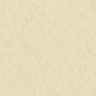
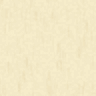
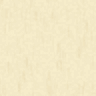
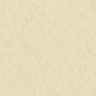
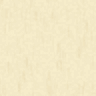
...
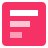
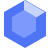
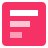
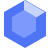
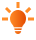

In [ ]:
get_file_txt(enlink, vilink)

In [2]:
import os

# Thư mục chứa các file txt
folder = "D:/crawl_data/Story131-139"
j=0
start = 108
for filename in os.listdir(folder):
    if filename.endswith(".txt"):
        filepath = os.path.join(folder, filename)

        # Đọc nội dung file
        with open(filepath, "r", encoding="utf-8") as f:
            content = f.read()

        # Tách ra title và content
        parts = content.split("\n\n", 1)  # chỉ tách lần đầu
        if len(parts) == 2:
            old_title, body = parts
            if j %2==1:
                giulai = old_title[:39]
                new_title = giulai + ' - CHƯƠNG ' + str(start + j//2)
            else:
                giulai = old_title[0:38]
                new_title = giulai + ' - CHAPTER ' + str(start + j//2)
            
                
            j+=1
            print(new_title)
            # Ví dụ: sửa title thành tên file (không đuôi .txt)

            # Ghép lại
            new_content = f"{new_title}\n\n{body}"

            # # Ghi đè lại file
            with open(filepath, "w", encoding="utf-8") as f:
                f.write(new_content)

            print(f"✅ Đã sửa {filename} -> title: {new_title}")
        else:
            print(f"⚠️ File {filename} không đúng cấu trúc")


STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 108
✅ Đã sửa story131_en.txt -> title: STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 108
TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 108
✅ Đã sửa story131_vi.txt -> title: TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 108
STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 109
✅ Đã sửa story132_en.txt -> title: STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 109
TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 109
✅ Đã sửa story132_vi.txt -> title: TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 109
STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 110
✅ Đã sửa story133_en.txt -> title: STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 110
TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 110
✅ Đã sửa story133_vi.txt -> title: TRUYỆN 'THE ACADEMY’S TIME STOP PLAYER' - CHƯƠNG 110
STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 111
✅ Đã sửa story134_en.txt -> title: STORY 'THE ACADEMY’S TIME STOP PLAYER' - CHAPTER 111
TRUYỆN 'THE A

In [3]:
%pip install pypdf

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not install packages due to an OSError: HTTPSConnectionPool(host='files.pythonhosted.org', port=443): Max retries exceeded with url: /packages/2c/83/2cacc506eb322bb31b747bc06ccb82cc9aa03e19ee9c1245e538e49d52be/pypdf-6.0.0-py3-none-any.whl.metadata (Caused by NewConnectionError('<pip._vendor.urllib3.connection.HTTPSConnection object at 0x00000270B0C6EC00>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed'))

